In [1]:
# Generating faces using gan network

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array
import cv2
import os
import tensorflow as tf
from tqdm import tqdm

2024-07-13 08:59:55.638798: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-13 08:59:55.638909: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-13 08:59:55.744069: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [3]:
data_path='/kaggle/input/face-mask-lite-dataset/without_mask'
images =[]

In [4]:
for img_name in tqdm(os.listdir(data_path)):
    img = cv2.imread(data_path+'/'+img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(128,128))
    img = img.astype(float)
    img = (img - 127.5) / 127.5
    images.append(img)
    

100%|██████████| 10000/10000 [09:45<00:00, 17.07it/s]


In [5]:
images[1].shape

(128, 128, 3)

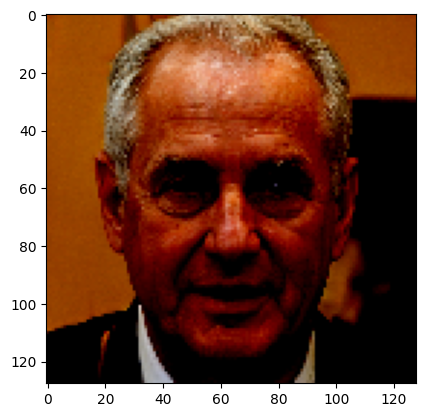

In [6]:
plt.imshow(images[6])

In [7]:
##Function to plot series of images 
def plot_images(images,sqr = 5,size=10):
    plt.figure(figsize = (size,size))
    plt.title("Real Images",fontsize = 35)
    for i in range(sqr * sqr):
        plt.subplot(sqr,sqr,i+1)
        plt.imshow(images[i]*0.5 + 0.5 )
        plt.xticks([])
        plt.yticks([])

/tmp/ipykernel_34/352081971.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(sqr,sqr,i+1)


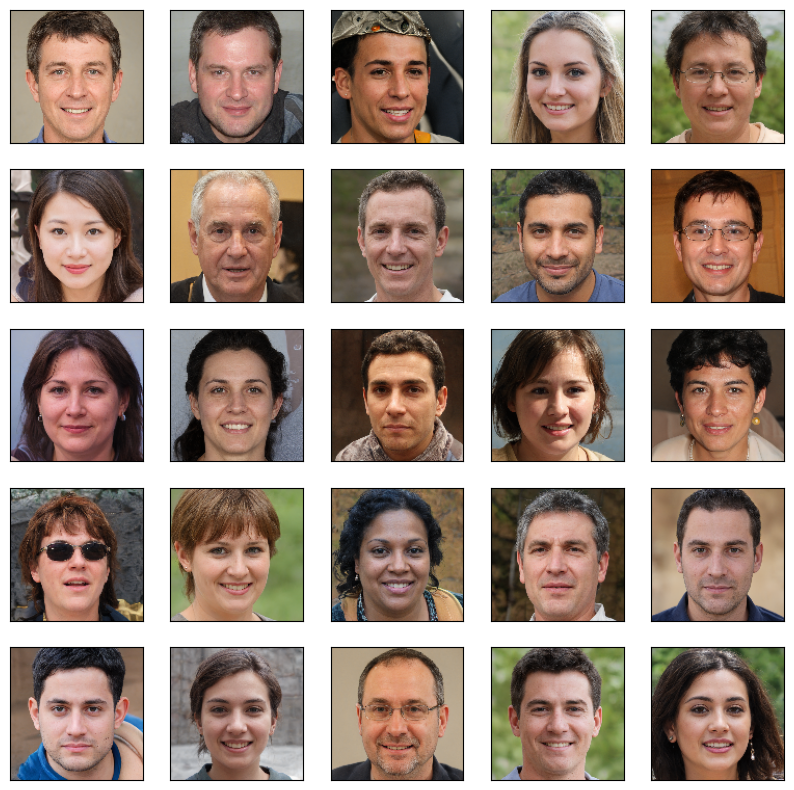

In [8]:
plot_images(images)

In [9]:
# making batches of data to feed to the generator model 
batch_size = 64
images = np.array(images)
df = tf.data.Dataset.from_tensor_slices(images).batch(batch_size)

# Making Models

In [10]:
from tensorflow import keras 
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, Dense, Conv2DTranspose, Dropout, LeakyReLU, Reshape,BatchNormalization, Input, Flatten


## Generator model

In [11]:
latent_dim = 100 #dimesnsion for my noise vector
def create_generator_model():
    model = Sequential()
    model.add(Dense(128*128*3,input_shape=(latent_dim,),use_bias=False))
    model.add(Reshape((128,128,3)))
    
    #first we will downsample image then we will upsace it till it reaches of our desired output dim
    model.add(Conv2D(128,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2D(128,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(64,64)
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    
    model.add(Conv2D(256,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2D(256,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(32,32)
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    
    model.add(Conv2D(512,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2D(512,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(16,16)
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    # now upscaling 
    model.add(Conv2DTranspose(512,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2DTranspose(512,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(32,32)
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    
    model.add(Conv2DTranspose(256,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2DTranspose(256,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(64,64)
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    
    model.add(Conv2DTranspose(128,4,strides =1,padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(Conv2DTranspose(128,4,strides =2,padding='same',kernel_initializer='he_normal', use_bias=False)) #output(128,128)
    model.add(BatchNormalization())
    model.add(Conv2DTranspose(3,4,strides =1,padding='same'))#output(128,128,3) which is RGB image
    
    return model
    

In [12]:
# making discriminator model

def create_discriminator_model():
    model = Sequential()
    model.add(Input((128,128,3)))
    model.add(Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Conv2D(512,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(LeakyReLU())
    model.add(Flatten())
    model.add(Dense(1,activation = 'sigmoid'))
    return model

In [13]:
generator_optimizer = tf.keras.optimizers.Adam( 0.0001 )
discriminator_optimizer = tf.keras.optimizers.Adam( 0.0001 )
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits = True)

In [14]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output),fake_output)


def discriminator_loss(fake_output, real_output):
    fake_loss = cross_entropy(tf.zeros_like(fake_output),fake_output)
    real_loss = cross_entropy(tf.ones_like(real_output),real_output)
    return fake_loss + real_loss


generator = create_generator_model()
generator.summary()

discriminator = create_discriminator_model()
discriminator.summary()


/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 49152)          │     4,915,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 128, 128, 128)  │         6,144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 64, 64, 128)    │       262,144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 64, 64, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 256)    │     1,048,576 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 32, 32, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 16, 16, 512)    │     4,194,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 512)    │     4,194,304 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 512)    │     4,194,304 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 32, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 32, 32, 256)    │     2,097,152 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 64, 64, 256)    │     1,048,576 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 64, 64, 256)    │         1,02

 Total params: 25,381,891 (96.82 MB)

 Trainable params: 25,378,307 (96.81 MB)

 Non-trainable params: 3,584 (14.00 KB)

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)               │ (None, 64, 64, 128)    │         6,144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 32, 32, 128)    │       262,144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 16, 16, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 8, 8, 256)      │     1,048,576 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 8, 8, 256)      │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_8 (LeakyReLU)       │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 4, 4, 512)      │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 4, 4, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,949,569 (15.07 MB)

 Trainable params: 3,948,033 (15.06 MB)

 Non-trainable params: 1,536 (6.00 KB)

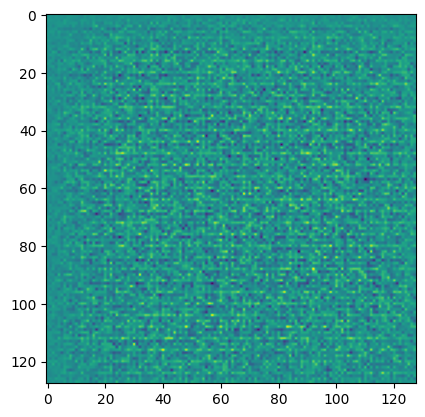

In [15]:
#Making Random noise
noise = np.random.normal(-1,1,(1,100))
img = generator(noise)
plt.imshow(img[0,:,:,0])

In [16]:
def train_model(images):
    noise = np.random.normal(-1,1,(batch_size,100))
    with tf.GradientTape() as gen_tape , tf.GradientTape() as disc_tape:
        
        generated_images = generator(noise)
        fake_output = discriminator(generated_images)
        real_output = discriminator(images)
        
        gen_loss = generator_loss(fake_output)
        dis_loss = discriminator_loss(fake_output, real_output)

        
    gradient_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)    
    gradient_of_discriminator = disc_tape.gradient(dis_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(gradient_of_generator,generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradient_of_discriminator, discriminator.trainable_variables))
    
    loss = {'gen loss':gen_loss,
           'disc loss': dis_loss}
    return loss

In [17]:
import time
def train(epochs,dataset):
    for epoch in range(epochs):
        start = time.time()
        print("\nEpoch : {}".format(epoch + 1))
        for images in dataset:
            loss = train_model(images)
        print(" Time:{}".format(np.round(time.time() - start),2)) 
        print("Generator Loss: {} Discriminator Loss: {}".format(loss['gen loss'],loss['disc loss']))
        plot_generated_images(3,epoch)

In [18]:
def plot_generated_images(square = 5, epochs = 0):
  plt.figure(figsize = (10,10))
  for i in range(square * square):
    if epochs != 0:    
        if(i == square //2):
            plt.title("Generated Image at Epoch:{}\n".format(epochs), fontsize = 32, color = 'black')
    plt.subplot(square, square, i+1)
    noise = np.random.normal(-1,1,(1,100))
    img = generator(noise)
    plt.imshow(np.clip((img[0,...]+1)/2, 0, 1))
    
    plt.xticks([])
    plt.yticks([])
    plt.grid()


Epoch : 1


/opt/conda/lib/python3.10/site-packages/keras/src/backend/tensorflow/nn.py:681: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


 Time:246.0
Generator Loss: 0.3057529330253601 Discriminator Loss: 5.045468330383301

Epoch : 2
 Time:227.0
Generator Loss: 0.8025768995285034 Discriminator Loss: 2.052241802215576

Epoch : 3
 Time:227.0
Generator Loss: 0.5392479300498962 Discriminator Loss: 1.7418924570083618

Epoch : 4
 Time:227.0
Generator Loss: 0.46552881598472595 Discriminator Loss: 1.5347089767456055

Epoch : 5
 Time:227.0
Generator Loss: 0.5214451551437378 Discriminator Loss: 1.669201374053955

Epoch : 6
 Time:226.0
Generator Loss: 0.4771419167518616 Discriminator Loss: 1.7801188230514526

Epoch : 7
 Time:227.0
Generator Loss: 0.3408288359642029 Discriminator Loss: 2.1849451065063477

Epoch : 8
 Time:227.0
Generator Loss: 0.9921395182609558 Discriminator Loss: 1.1633292436599731

Epoch : 9
 Time:227.0
Generator Loss: 0.821639895439148 Discriminator Loss: 1.4405384063720703

Epoch : 10
 Time:226.0
Generator Loss: 0.6579136848449707 Discriminator Loss: 1.7010926008224487


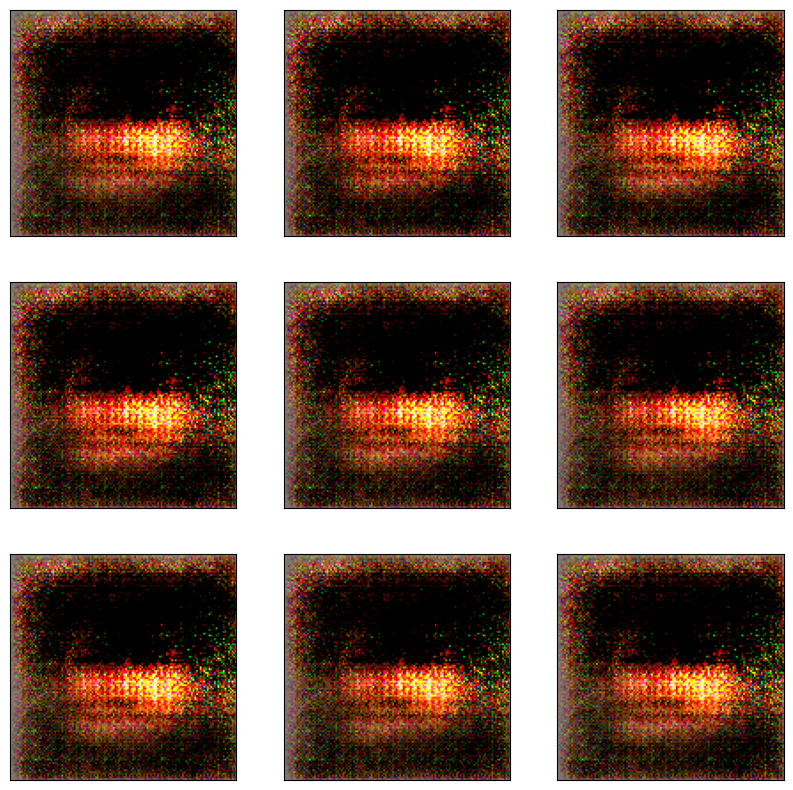

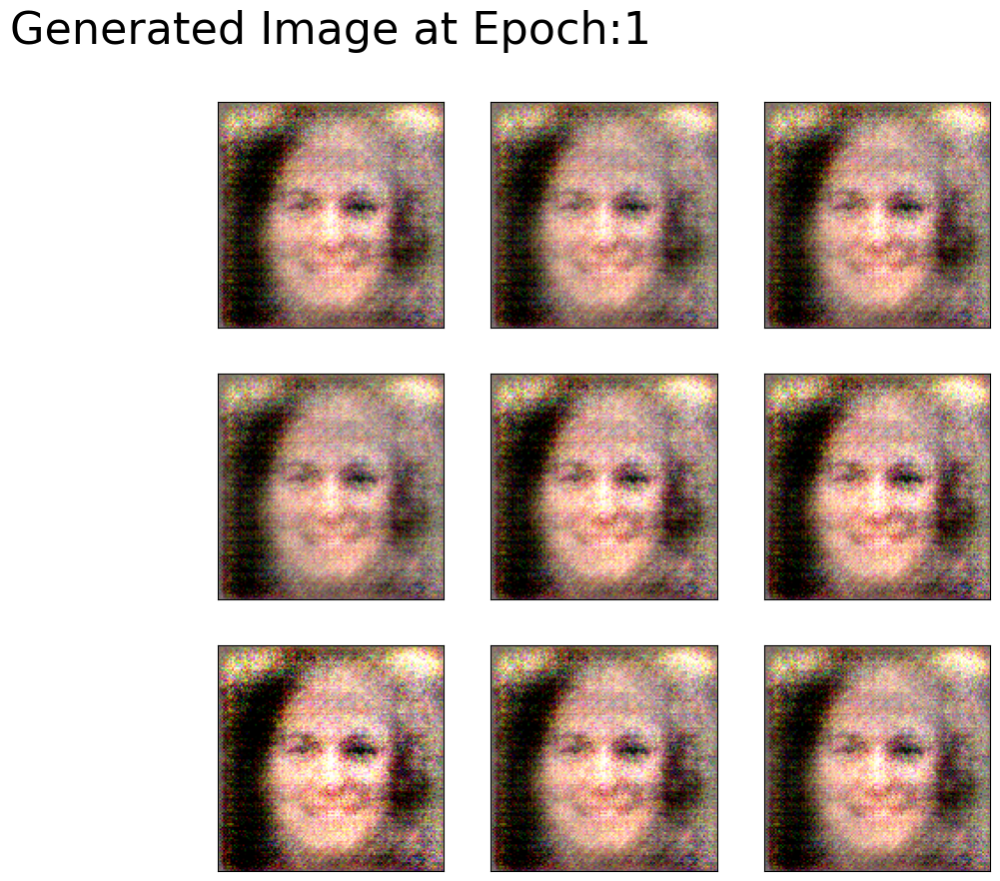

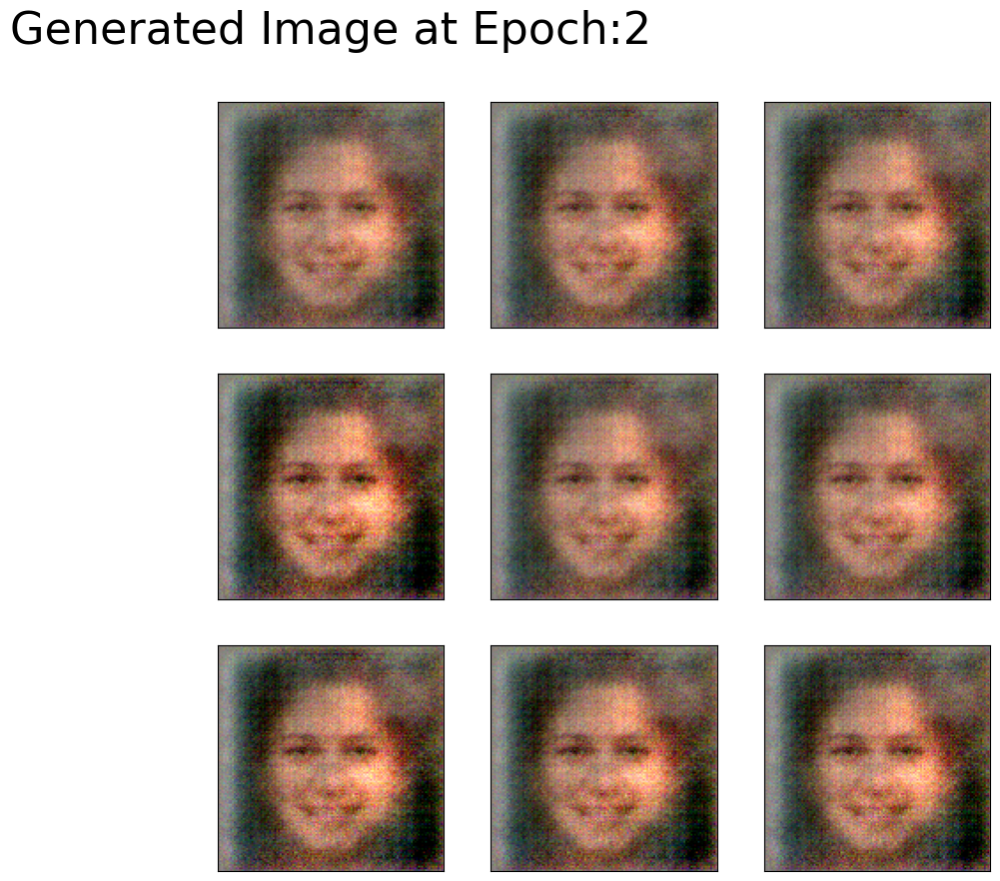

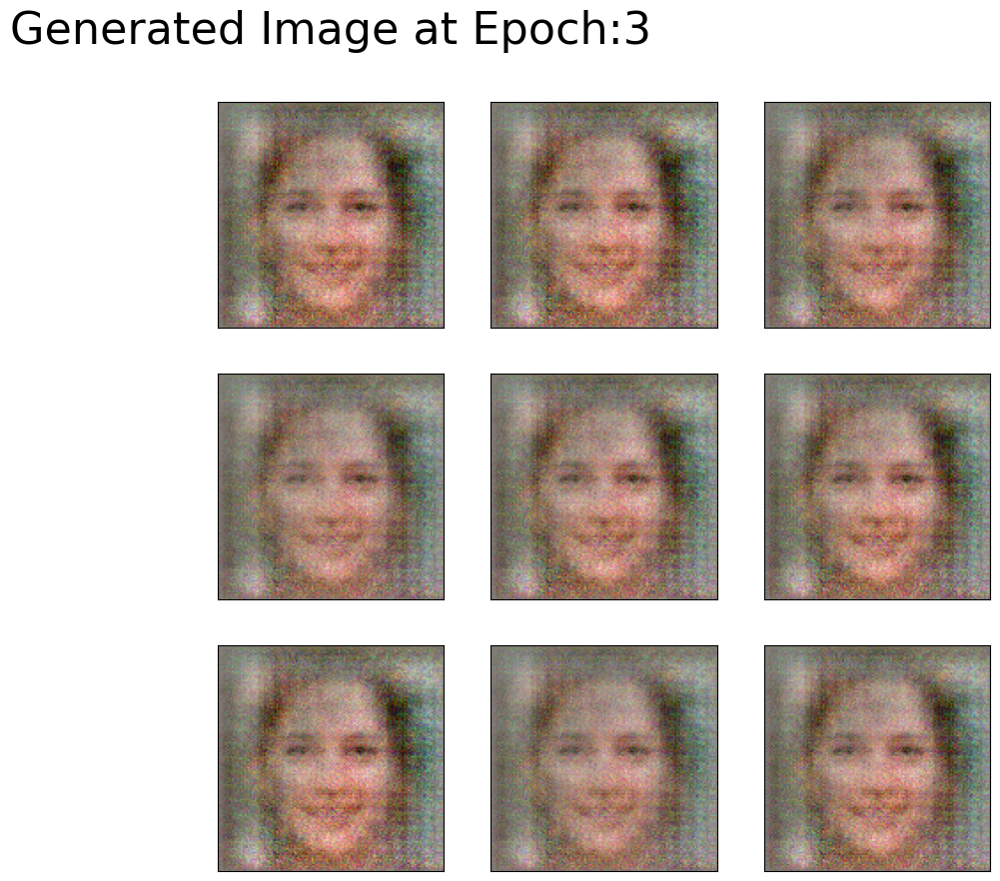

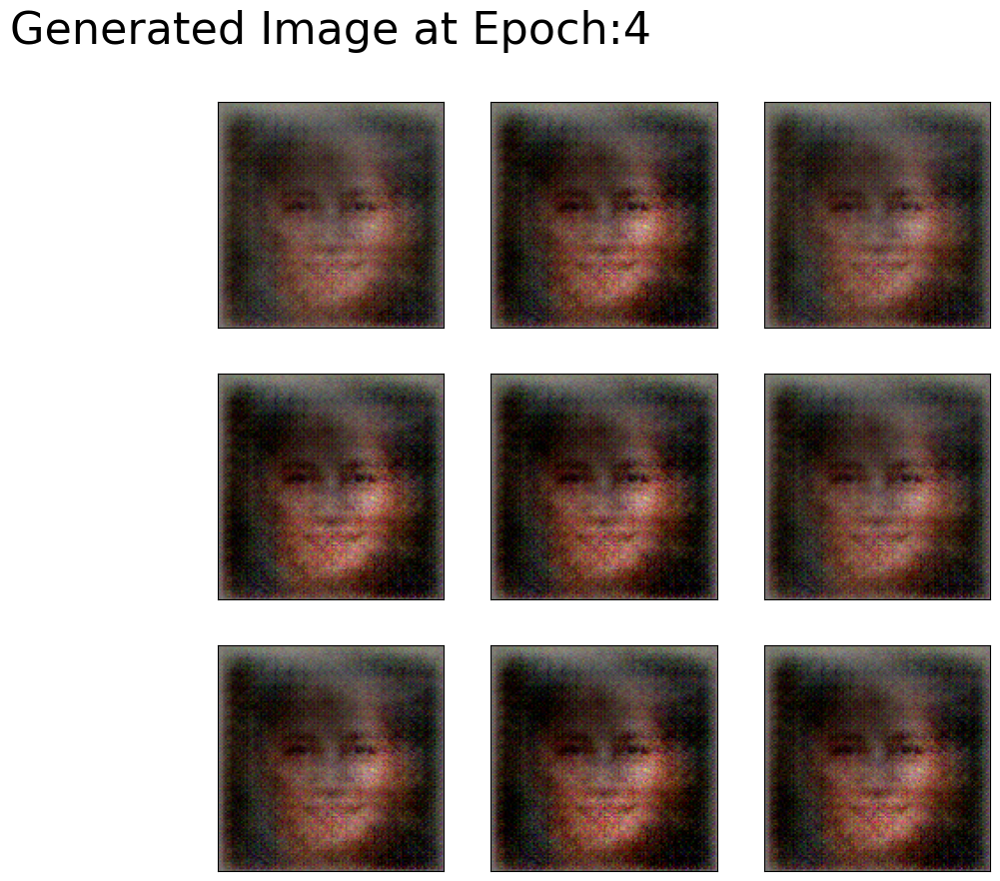

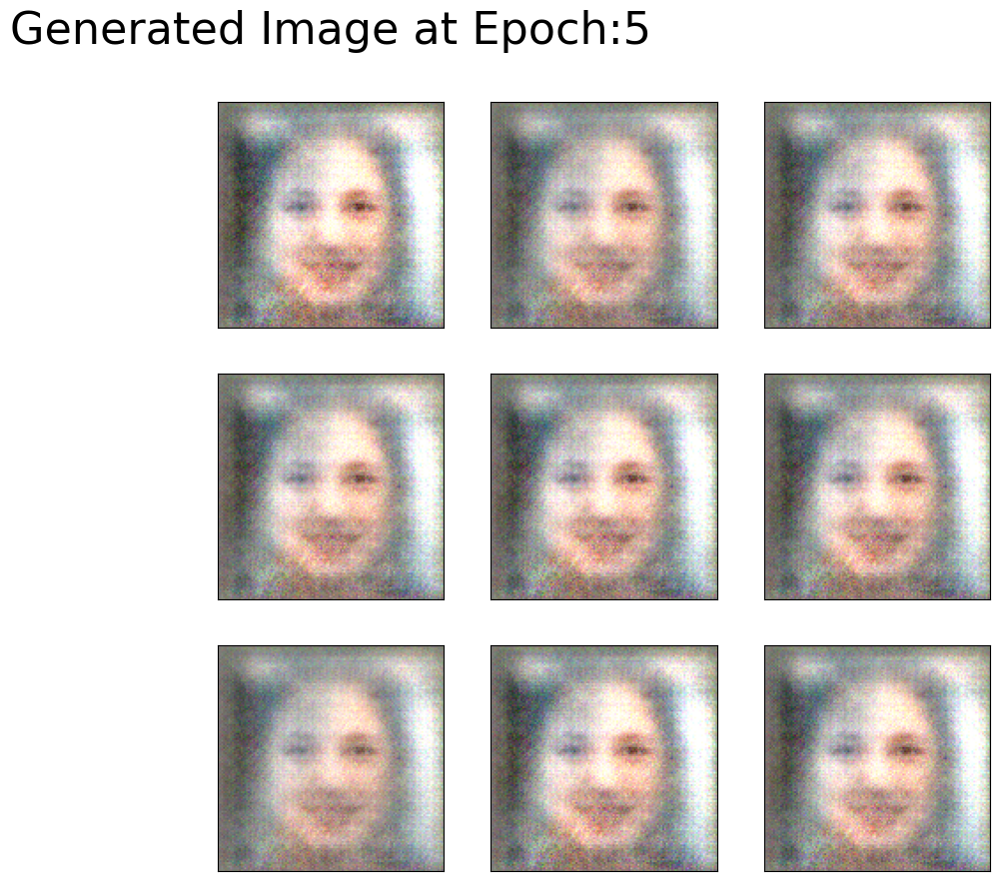

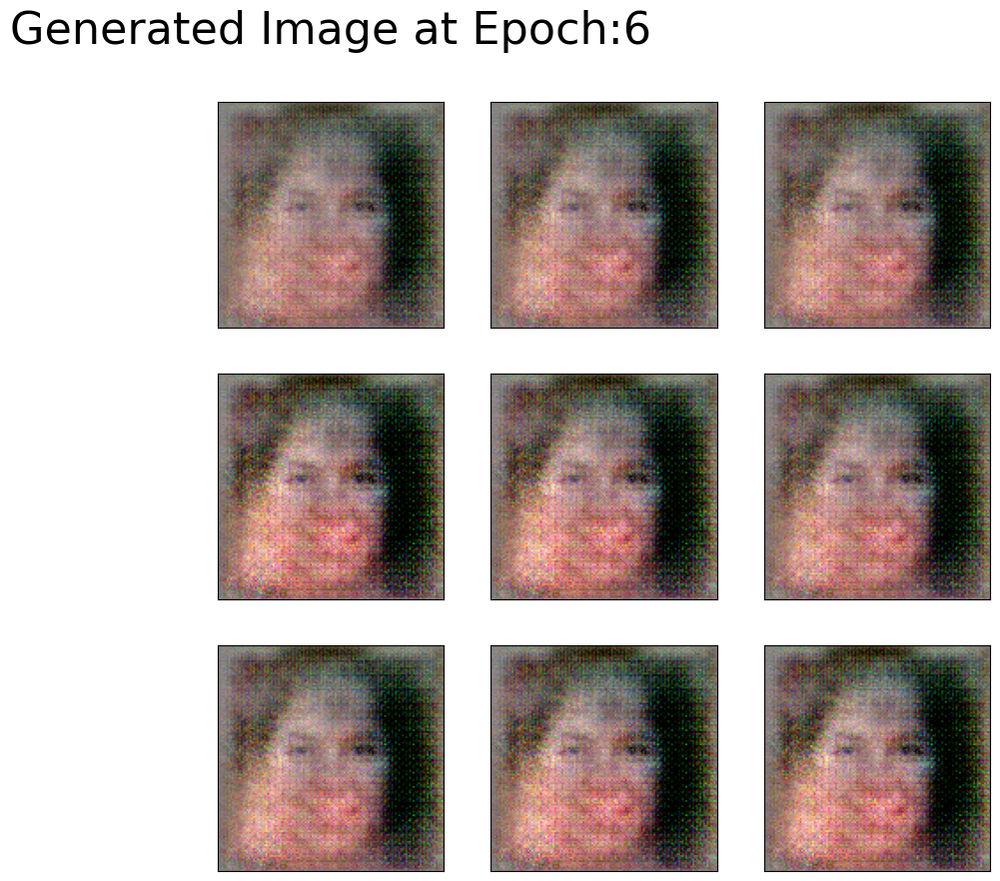

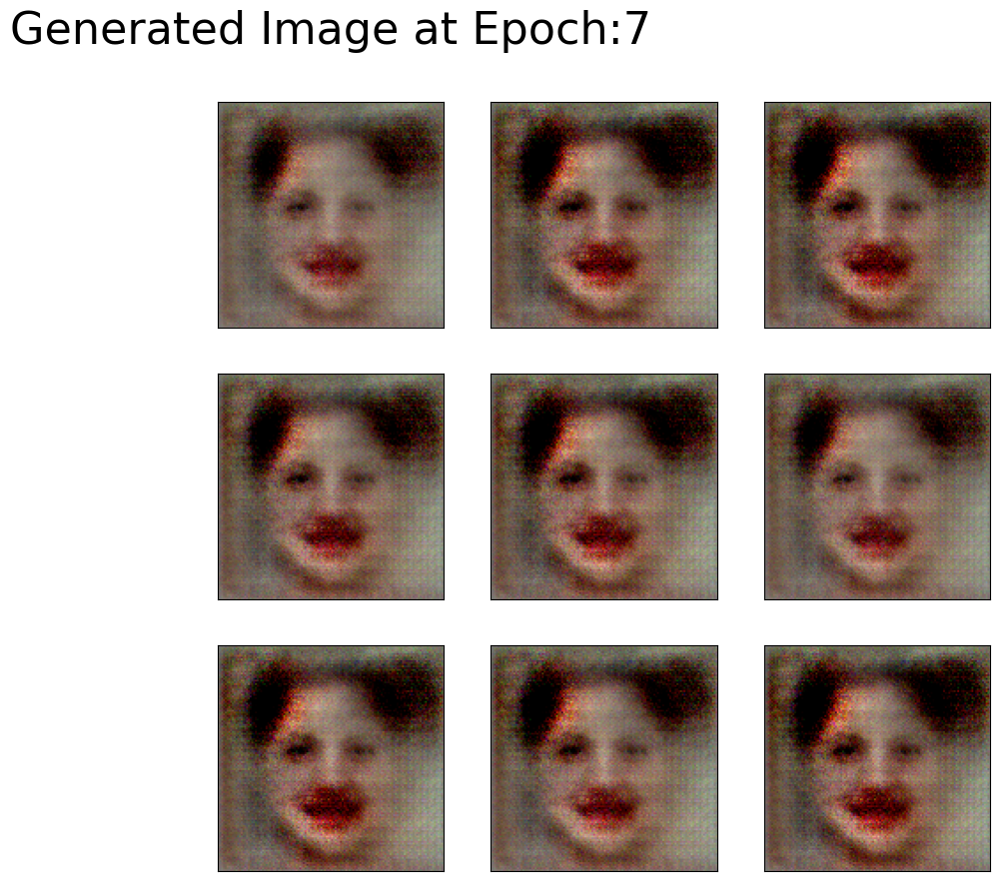

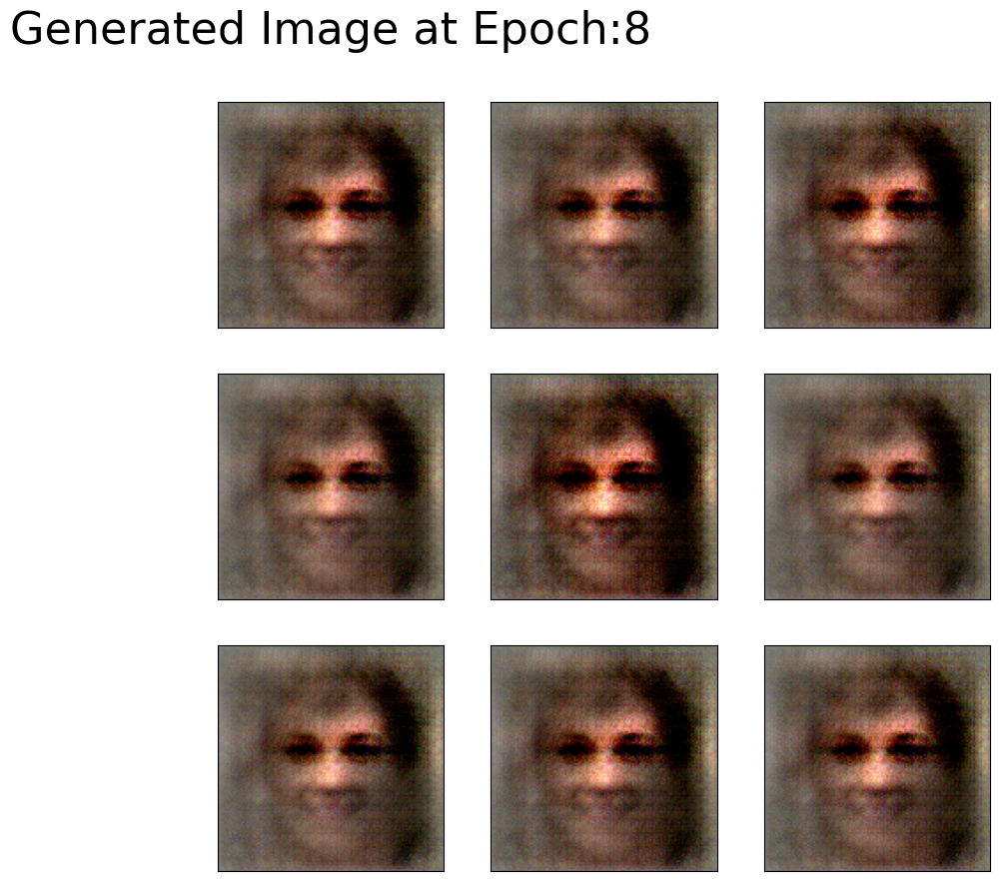

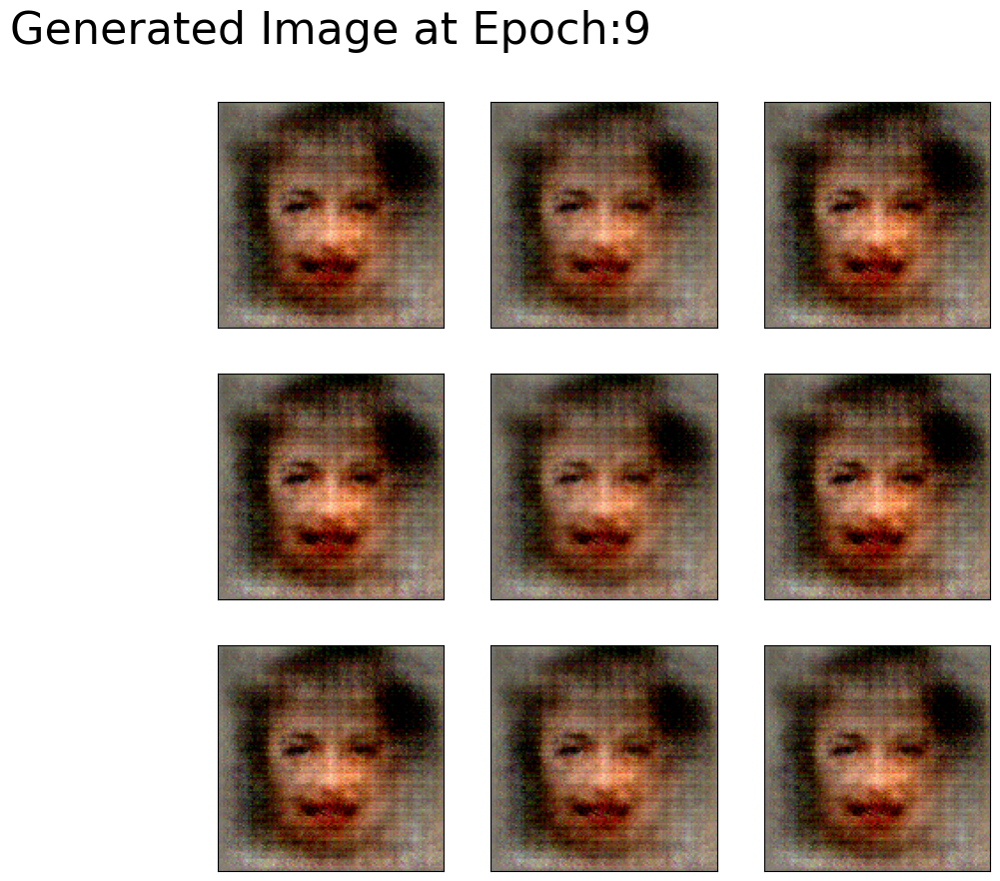

In [19]:
train(10,df)


Epoch : 1
 Time:226.0
Generator Loss: 0.7489550113677979 Discriminator Loss: 1.440865159034729

Epoch : 2
 Time:226.0
Generator Loss: 0.6121008396148682 Discriminator Loss: 1.51127290725708

Epoch : 3
 Time:226.0
Generator Loss: 0.33971282839775085 Discriminator Loss: 1.649617314338684

Epoch : 4
 Time:226.0
Generator Loss: 0.5373042225837708 Discriminator Loss: 1.4933431148529053

Epoch : 5
 Time:226.0
Generator Loss: 0.9084323644638062 Discriminator Loss: 1.3846079111099243

Epoch : 6
 Time:226.0
Generator Loss: 0.564034104347229 Discriminator Loss: 1.7052429914474487

Epoch : 7
 Time:226.0
Generator Loss: 0.44254010915756226 Discriminator Loss: 1.5137155055999756

Epoch : 8
 Time:226.0
Generator Loss: 0.7424009442329407 Discriminator Loss: 1.1240097284317017

Epoch : 9
 Time:226.0
Generator Loss: 0.40830421447753906 Discriminator Loss: 2.182403087615967

Epoch : 10
 Time:226.0
Generator Loss: 0.833828866481781 Discriminator Loss: 1.6194578409194946

Epoch : 11
 Time:226.0
Generator

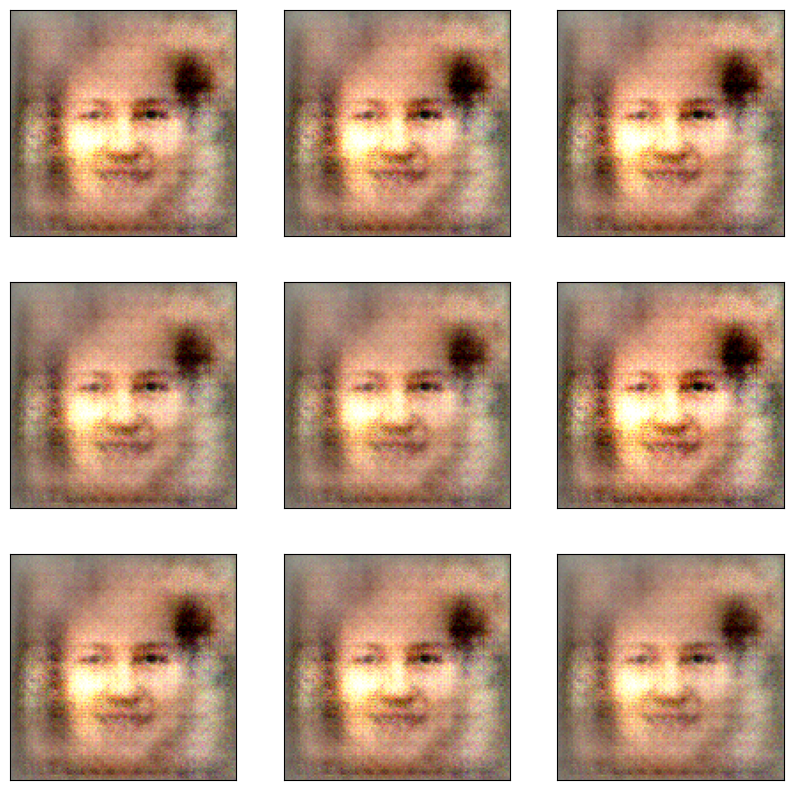

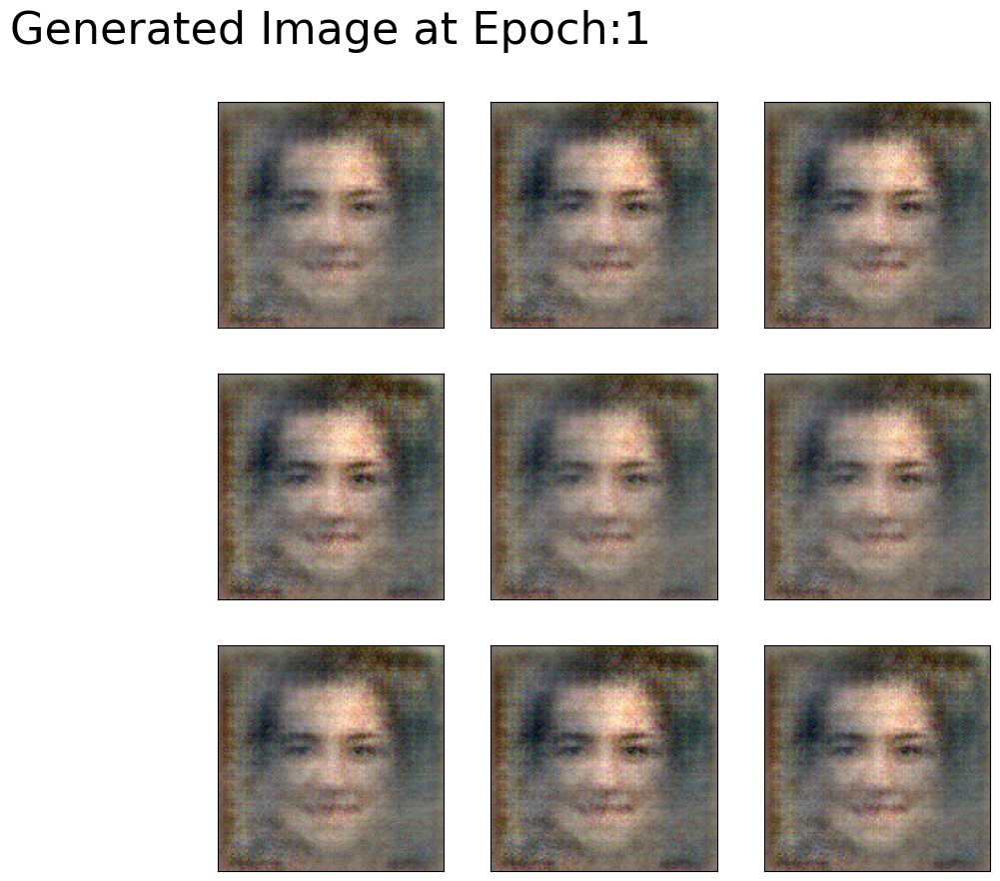

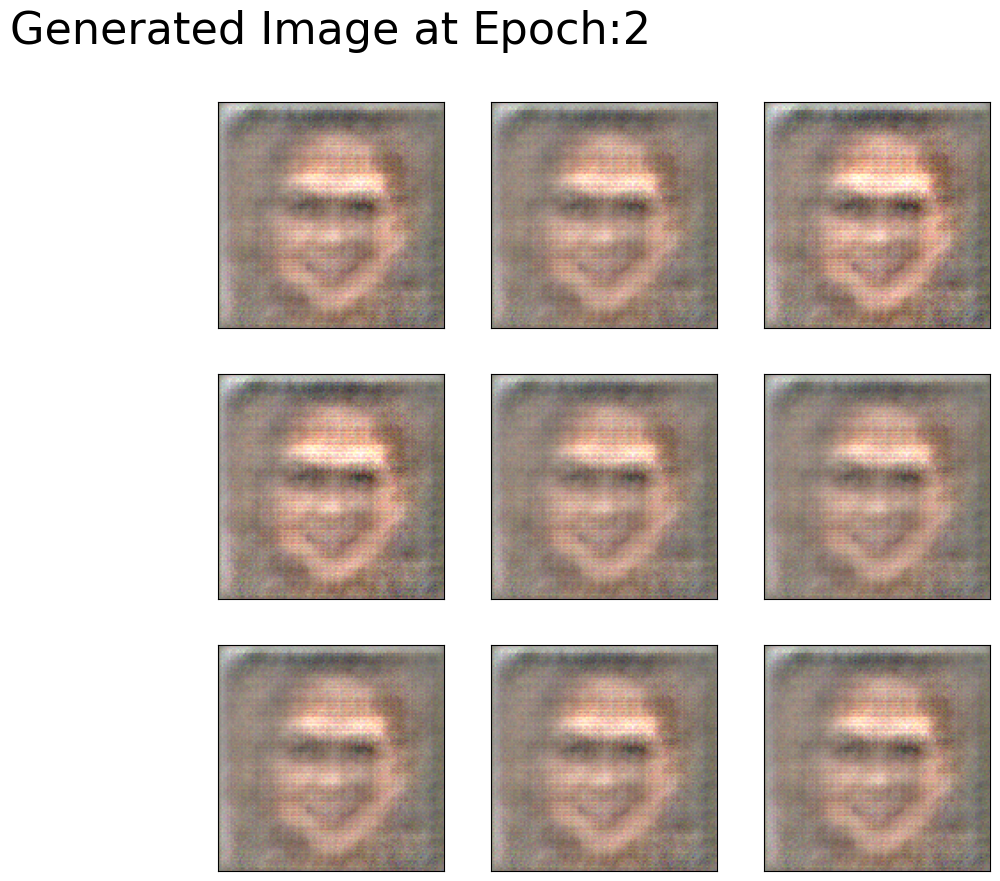

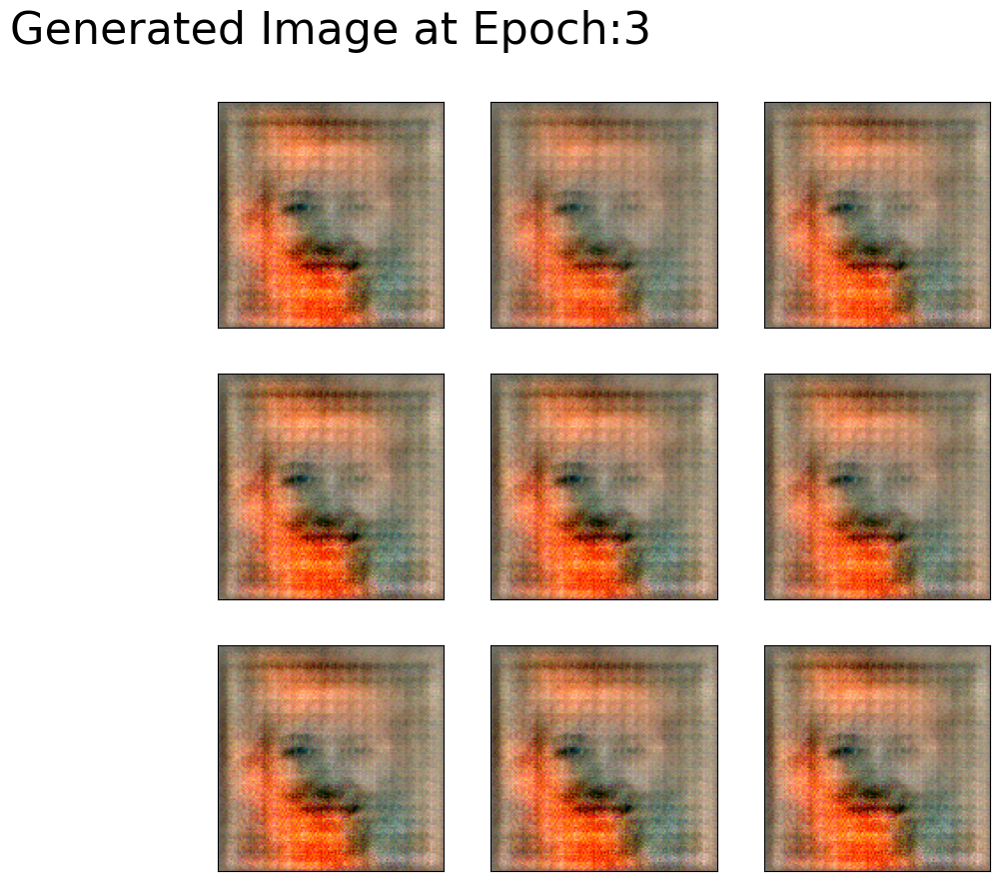

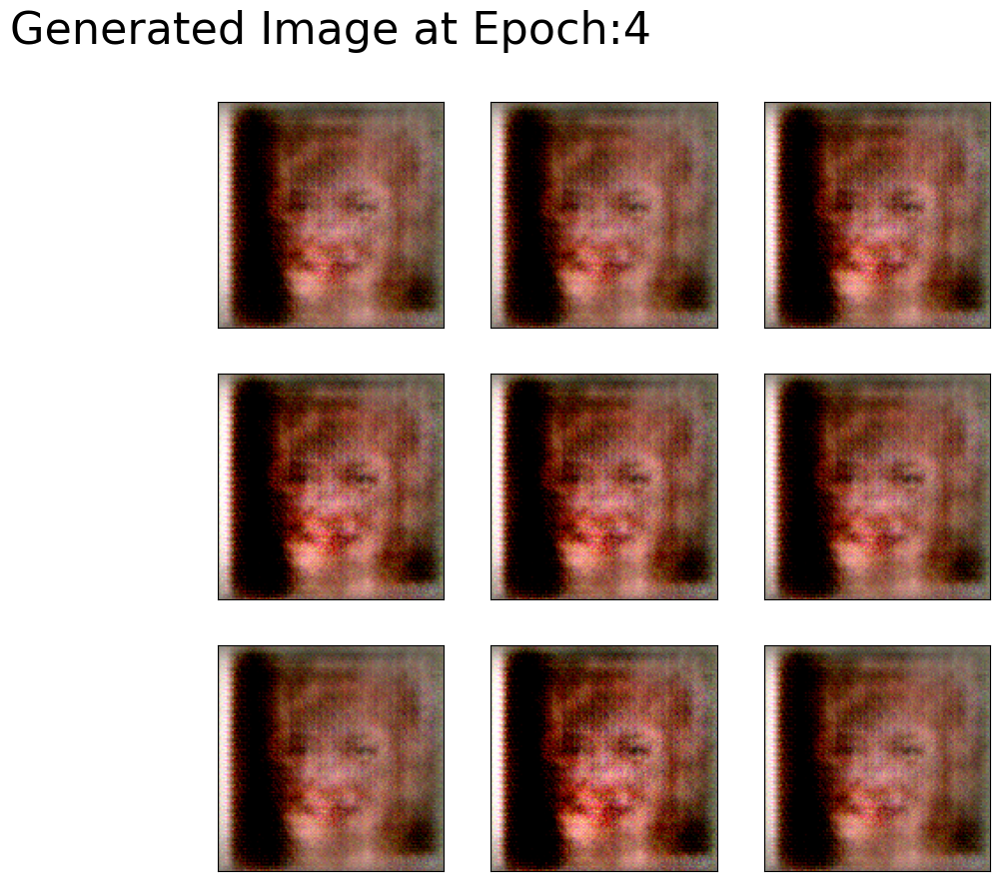

...

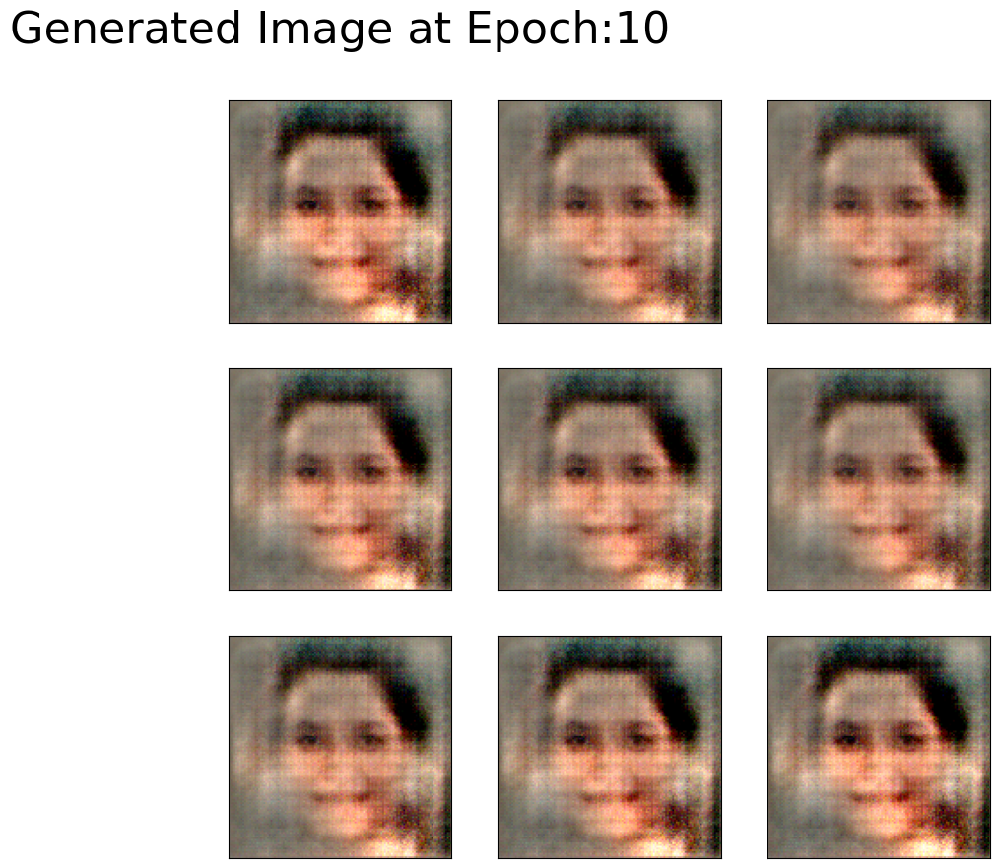

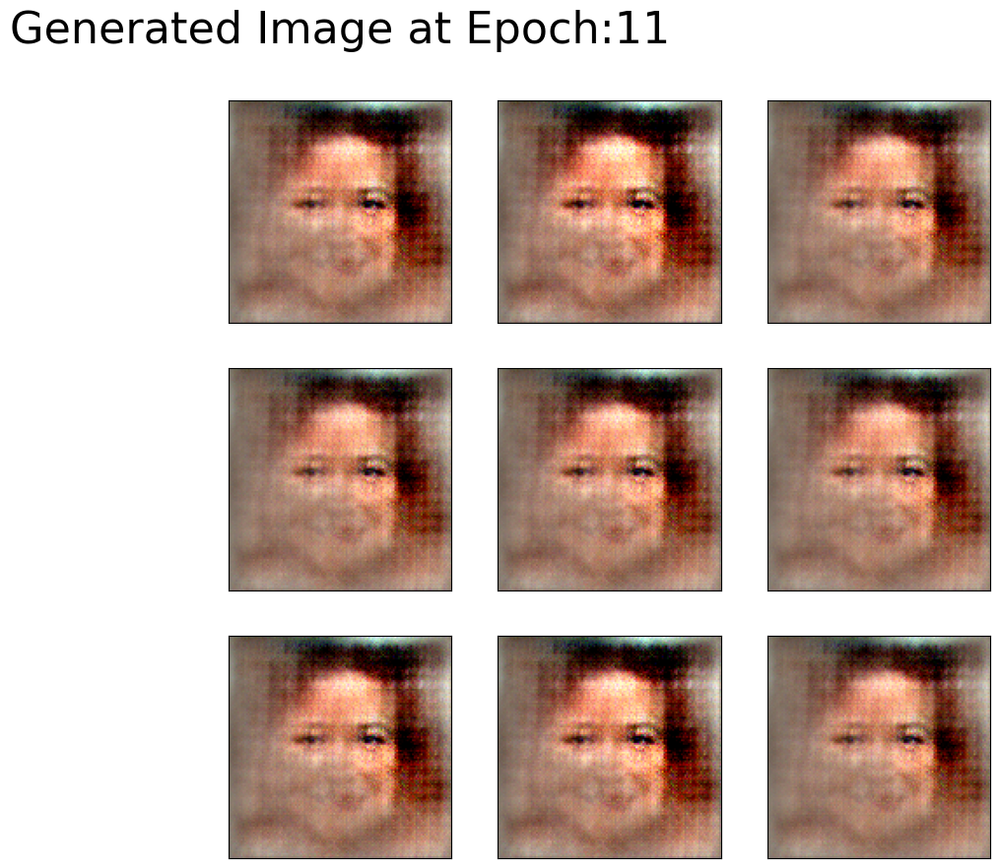

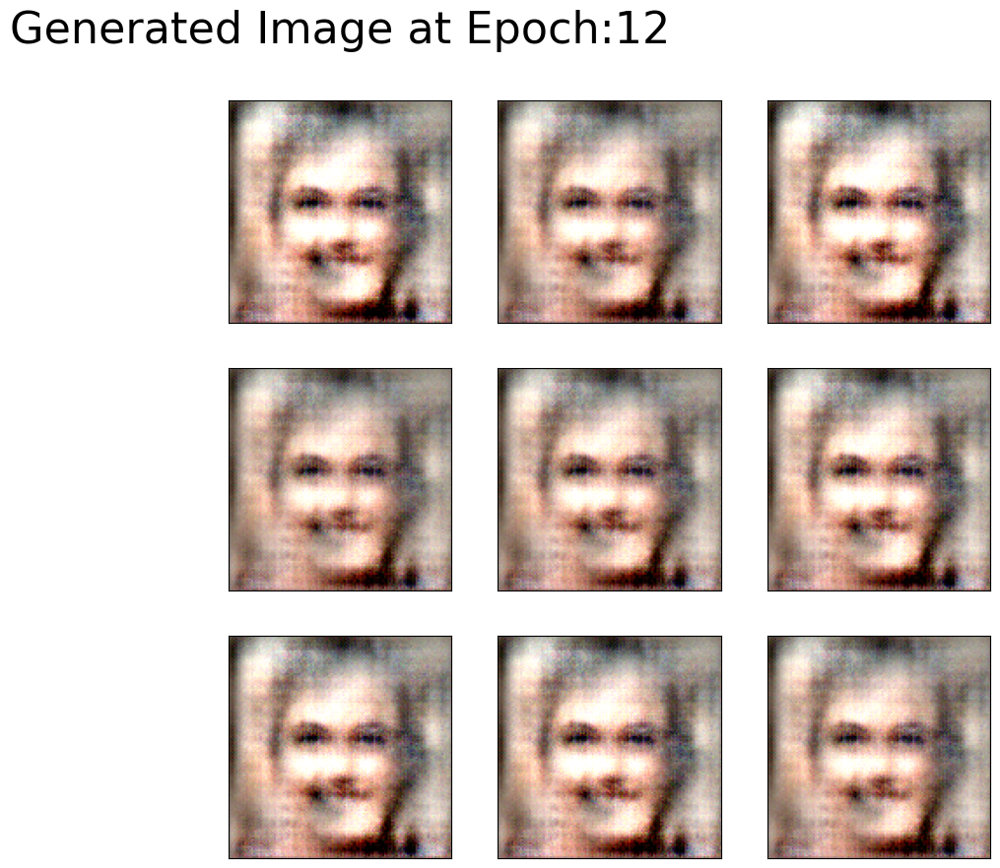

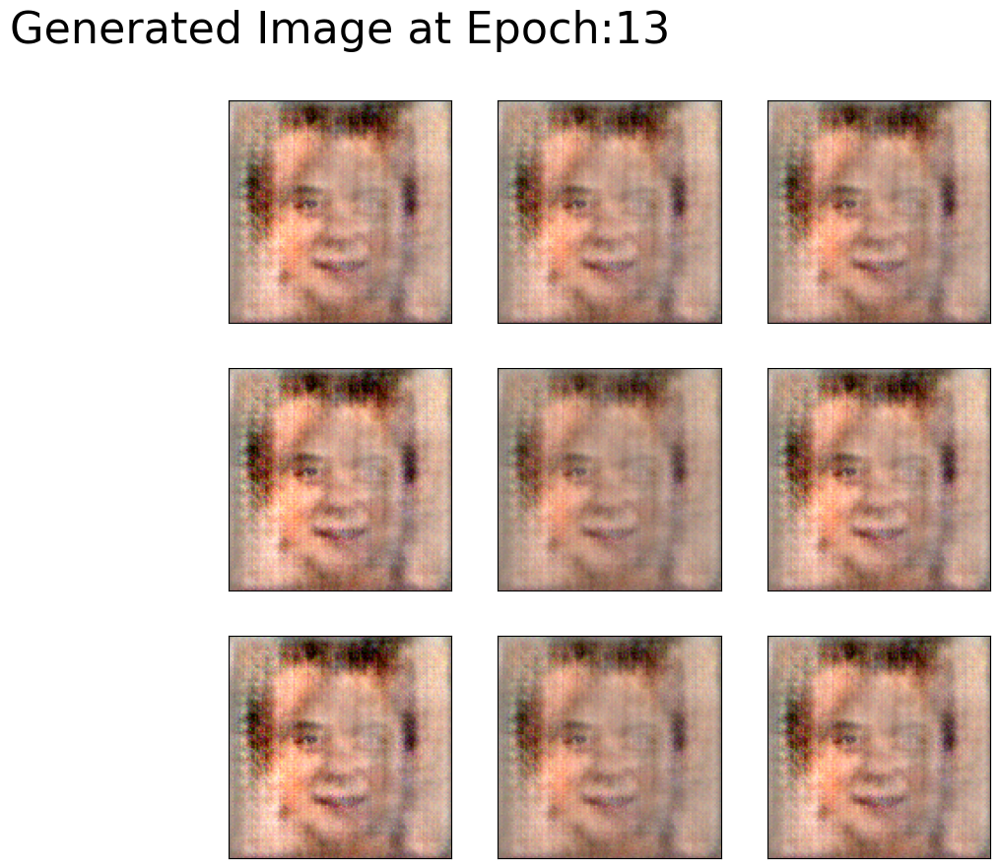

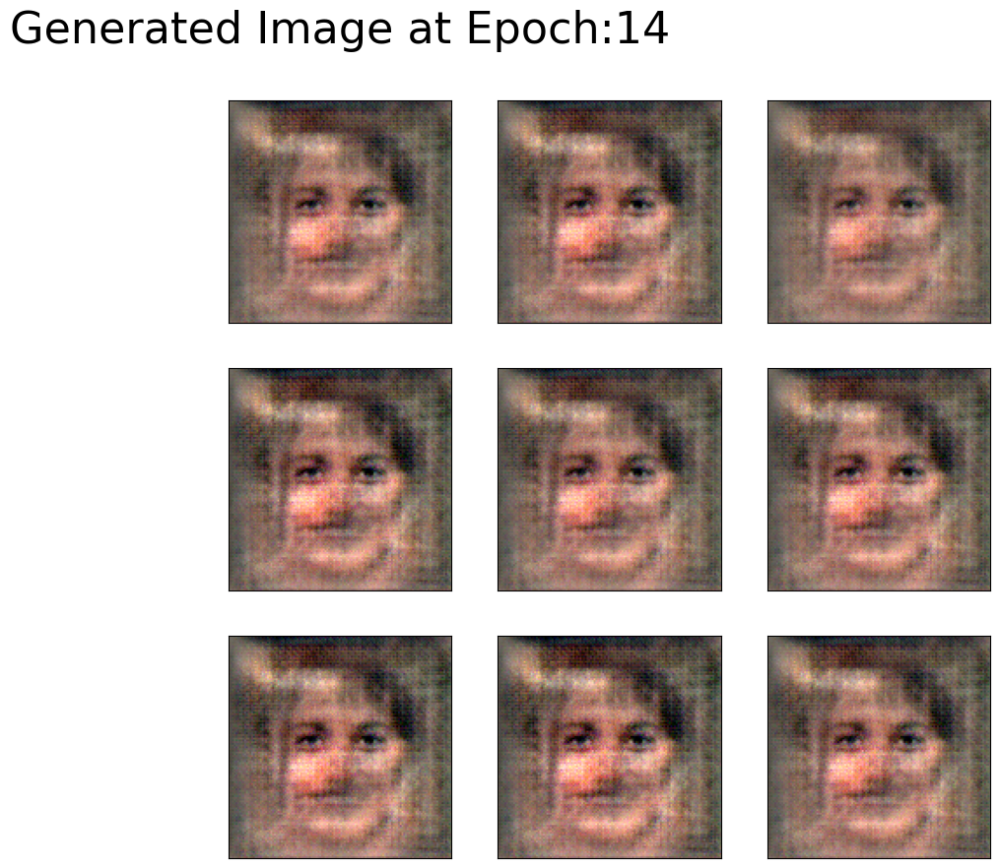

In [20]:
train(15,df)

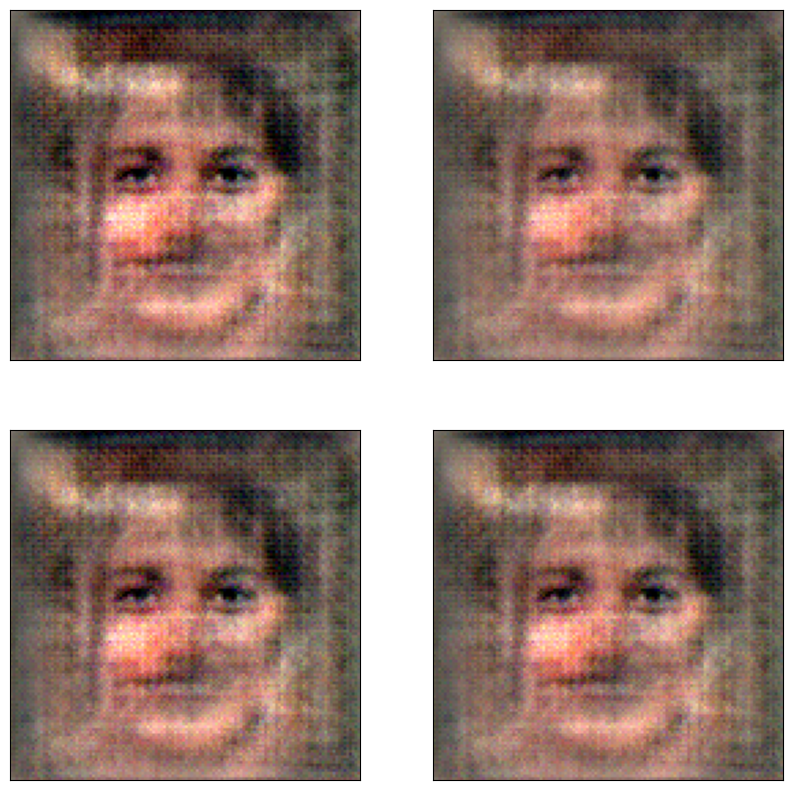

In [21]:
plot_generated_images(2)